<a href="https://colab.research.google.com/github/OoJackoO/MMAI894_Deep-Learning-Course-Project/blob/Irene_Notebook/MMAI_Dataset_Feb_15.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
#@title Here I download the Data from Kaggle

! pip install -q kaggle

•	Choose the kaggle.json file that you downloaded

In [2]:
from google.colab import files
files.upload()


Saving kaggle.json to kaggle.json


{'kaggle.json': b'{"username":"ingugi","key":"0b59923e89cbc4cd04dbec9bfb30428d"}'}

•	Make directory named kaggle and copy kaggle.json file there

In [3]:
! mkdir ~/.kaggle
! cp kaggle.json ~/.kaggle/


•	Change the permissions of the file.

In [4]:
! chmod 600 ~/.kaggle/kaggle.json

• Find the Dataset in content

In [5]:
!pwd

/content


In [6]:
!ls /content/Tomato_Dataset

train  valid


• Unzip file

In [7]:
!kaggle datasets download -d cookiefinder/tomato-disease-multiple-sources

100% 1.37G/1.37G [00:21<00:00, 93.9MB/s]
100% 1.37G/1.37G [00:21<00:00, 67.9MB/s]


In [8]:
! unzip tomato-disease-multiple-sources.zip -d Tomato_Dataset

Streaming output truncated to the last 5000 lines.
  inflating: Tomato_Dataset/valid/Late_blight/9afc2537-1b13-4c25-b5ed-5b8de511b0ab___GHLB2 Leaf 9033.JPG  
  inflating: Tomato_Dataset/valid/Late_blight/9bb49d22-976d-40c3-bc9a-bff5cbbd8e28___RS_Late.B 5057.JPG  
  inflating: Tomato_Dataset/valid/Late_blight/9c274db5-2f89-4f3c-b9e2-4d5ebc54ddad___GHLB2 Leaf 9096.JPG  
  inflating: Tomato_Dataset/valid/Late_blight/9c726f4e-045b-4080-b53d-d7e66d45bcb1___RS_Late.B 4876.JPG  
  inflating: Tomato_Dataset/valid/Late_blight/9e5dd34f-124c-4a64-ba9f-77c8d05faa9c___GHLB2 Leaf 8749.JPG  
  inflating: Tomato_Dataset/valid/Late_blight/9e633823-3dde-450c-8172-733021e4dff0___RS_Late.B 6414.JPG  
  inflating: Tomato_Dataset/valid/Late_blight/9ecb8001-2f48-4487-b287-535dbcfb5c2f___RS_Late.B 6206.JPG  
  inflating: Tomato_Dataset/valid/Late_blight/9f7dcd60-e691-4c1e-830e-7495f7cc123d___RS_Late.B 6166.JPG  
  inflating: Tomato_Dataset/valid/Late_blight/Bacterial_spots2276_jpg.rf.5becd3793ec2a532bf8f111d6

View images in Valid Dataset

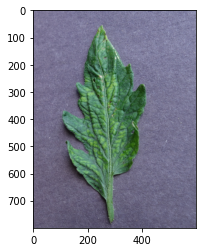

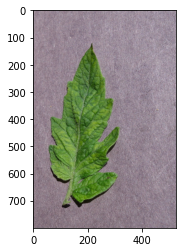

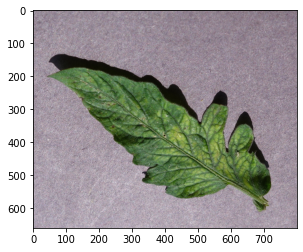

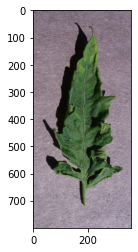

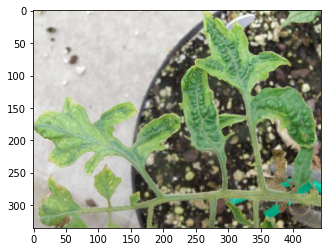

...

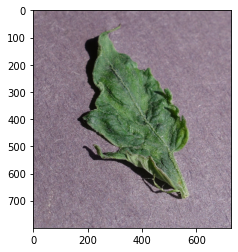

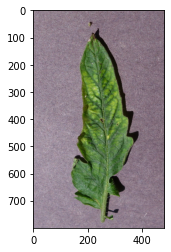

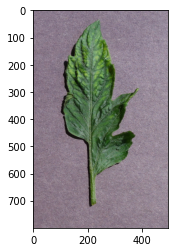

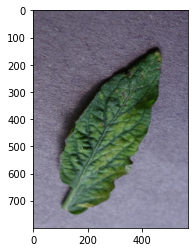

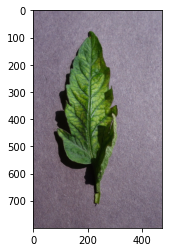

In [9]:
import matplotlib.pyplot as plt
import os

# Set the directory path
dir_path = '/content/Tomato_Dataset/valid/Tomato_mosaic_virus'

# Loop over the contents of the directory and display each file
for file_name in os.listdir(dir_path):
    # Check if the file is an image
    if file_name.endswith('.jpg') or file_name.endswith('.jpeg') or file_name.endswith('.png'):
        # Load the image
        img = plt.imread(os.path.join(dir_path, file_name))

        # Display the image
        plt.imshow(img)
        plt.show()



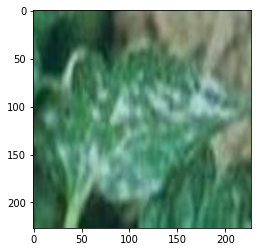

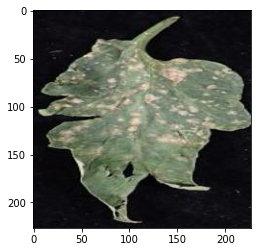

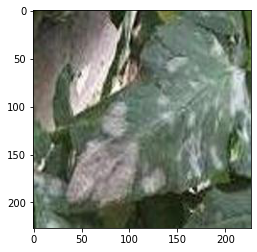

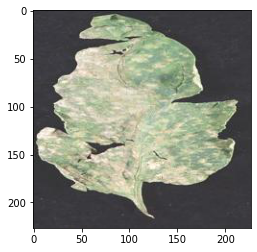

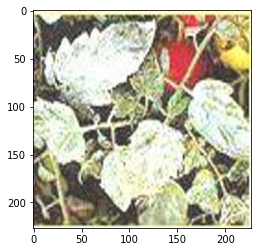

...

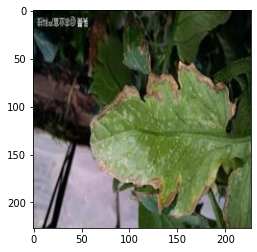

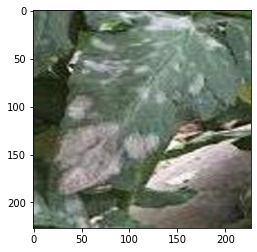

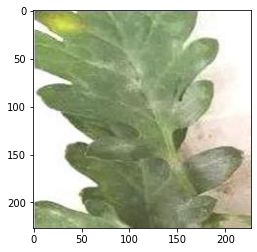

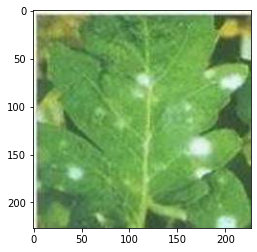

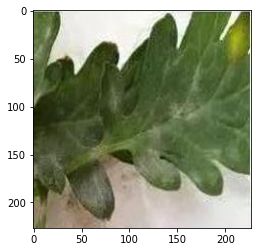

In [10]:
import matplotlib.pyplot as plt
import os

# Set the directory path
dir_path = '/content/Tomato_Dataset/valid/powdery_mildew'

# Loop over the contents of the directory and display each file
for file_name in os.listdir(dir_path):
    # Check if the file is an image
    if file_name.endswith('.jpg') or file_name.endswith('.jpeg') or file_name.endswith('.png'):
        # Load the image
        img = plt.imread(os.path.join(dir_path, file_name))

        # Display the image
        plt.imshow(img)
        plt.show()

View images side by side

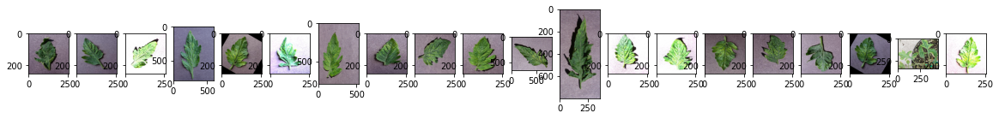

In [11]:
import matplotlib.pyplot as plt
import os

# Set the directory path
dir_path = '/content/Tomato_Dataset/valid/Tomato_mosaic_virus'

# Set the number of images to display
num_images = 20

# Create a grid of subplots
fig, axes = plt.subplots(nrows=1, ncols=num_images, figsize=(20, 4))

# Loop over the images and plot each one in a separate subplot
for i, file_name in enumerate(os.listdir(dir_path)[:num_images]):
    # Load the image
    img = plt.imread(os.path.join(dir_path, file_name))

    # Plot the image in a subplot
    axes[i].imshow(img)

# Display the subplots
plt.show()


Here I split the dataset into training and validation sets, using Python's os and shutil modules

In [12]:
import os
import shutil

# Set up directories for training and validation data
train_dir = 'Tomato_Dataset/train'
valid_dir = 'Tomato_Dataset/valid'

# Make directories if they don't exist
os.makedirs(train_dir, exist_ok=True)
os.makedirs(valid_dir, exist_ok=True)

# Specify the validation split percentage
valid_pct = 0.2

# Iterate over the directories in the original dataset
for cls in os.listdir('Tomato_Dataset'):
    if cls in ['train', 'valid']:
        continue
    
    # Create class directories in train and valid directories
    os.makedirs(os.path.join(train_dir, cls), exist_ok=True)
    os.makedirs(os.path.join(valid_dir, cls), exist_ok=True)
    
    # Get a list of image filenames for the current class
    filenames = os.listdir(os.path.join('Tomato_Dataset', cls))
    
    # Split the filenames into train and validation sets
    valid_size = int(len(filenames) * valid_pct)
    valid_filenames = filenames[:valid_size]
    train_filenames = filenames[valid_size:]
    
    # Copy the train images to the train directory
    for filename in train_filenames:
        src = os.path.join('Tomato_Dataset', cls, filename)
        dst = os.path.join(train_dir, cls, filename)
        shutil.copyfile(src, dst)
    
    # Copy the validation images to the validation directory
    for filename in valid_filenames:
        src = os.path.join('Tomato_Dataset', cls, filename)
        dst = os.path.join(valid_dir, cls, filename)
        shutil.copyfile(src, dst)




Here I processed the images by resizing them to a consistent size for efficient computation and so they all have the same dimensions to reduce distortions and normalizing the pixel values, (scaling between 0 & 1) to make the training process more stable 

In [15]:
from PIL import Image

def preprocess_image(image_path, target_size):
    """Preprocesses an image by resizing it to a target size and normalizing the pixel values."""
    # Open the image using Pillow
    image = Image.open(image_path)

    # Resize the image to the target size
    image = image.resize(target_size)

    # Convert the image to a NumPy array and normalize the pixel values
    image = np.array(image, dtype=np.float32) / 255.0

    return image


This model consists of four convolutional layers with max pooling followed by two fully connected layers. The input images are expected to be of size 224x224 with 3 channels (RGB). The output layer has 2 neurons, representing the classes "healthy" and "unhealthy". The activation function of the output layer is softmax, which ensures that the outputs are probabilities that sum to 1.

In [17]:
import tensorflow as tf
from tensorflow.keras import layers

# Define the model architecture
model = tf.keras.Sequential([
    layers.Conv2D(32, (3,3), activation='relu', input_shape=(224,224,3)),
    layers.MaxPooling2D((2,2)),
    layers.Conv2D(64, (3,3), activation='relu'),
    layers.MaxPooling2D((2,2)),
    layers.Conv2D(128, (3,3), activation='relu'),
    layers.MaxPooling2D((2,2)),
    layers.Conv2D(256, (3,3), activation='relu'),
    layers.MaxPooling2D((2,2)),
    layers.Flatten(),
    layers.Dense(512, activation='relu'),
    layers.Dense(2, activation='softmax')
])

# Print the model summary
model.summary()



Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 222, 222, 32)      896       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 111, 111, 32)     0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 109, 109, 64)      18496     
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 54, 54, 64)       0         
 2D)                                                             
                                                                 
 conv2d_2 (Conv2D)           (None, 52, 52, 128)       73856     
                                                                 
 max_pooling2d_2 (MaxPooling  (None, 26, 26, 128)      0